In [3]:
import numpy as np
import numpy as np
import pysindy as ps
import matplotlib.pyplot as plt
from scipy.sparse.linalg import svds
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
#%matplotlib notebook

# Exploratory data analysis of trajectories

We have some big tensor of dimensions $\boldsymbol{X}=(50, 50, 801, 30)$. We flatten the spatial dimensions, so we end up with dimensions $(2500, 801, 30)$. 

To properly fetch the spatial modes we rearrange the matrix to have dimensions $2500 \times (801 \cdot 30)$.

We are stacking all realizations horizontally across time.

$$
\boldsymbol{X}=[\boldsymbol{X}^{(1)}(t_1) \boldsymbol{X}^{(1)}(t_2) \dots \boldsymbol{X}^{(1)}(t_{801}) \boldsymbol{X}^{(2)}(t_1) \dots \boldsymbol{X}^{(30)}(t_{801})]
$$

Here $\boldsymbol{X}^{(i)}(t_n) \in \mathbb{R}^{2500 \times 1}$. Notice that we use the **same initial conditions**, but different coupling parameters.

In [56]:
# Extract data, and stack it.

data = np.load("simulation_data/rd_spiral/rd_spiral_mu_0.800_to_1.500_d1_0.01_d2_0.01_m_1_beta_1.1.npz")
# data = np.load("simulation_data/rd_spiral/rd_spiral_beta_0.8_1.0.npz")
u = data['u']
v = data['v']

t = u.shape[2]
flat_dim = u.shape[0] * u.shape[1]
realizations = u.shape[3]

u = u.reshape((flat_dim, t, realizations))
v = v.reshape((flat_dim, t, realizations))

u = u - np.mean(u, axis=1, keepdims=True)
v = v - np.mean(v, axis=1, keepdims=True)

# u_flat = u_flat.reshape((flat_dim, t * realizations))
# v_flat = v_flat.reshape((flat_dim, t * realizations))

After loading the data we compute the first 20 spatial modes with SVD

In [61]:
u_realization = u[:, :, 1]
v_realization = v[:, :, 1]

full_uv = np.vstack((u_realization, v_realization))

k = 20
U, S, VT = svds(full_uv, k=k, which='LM')

We produce the scree and cumulative energy plots. We can take the first 4 POD modes...
It is interesting to see that despite the many parameters we still end up with most of the energy contained in the first 2 spatial modes.

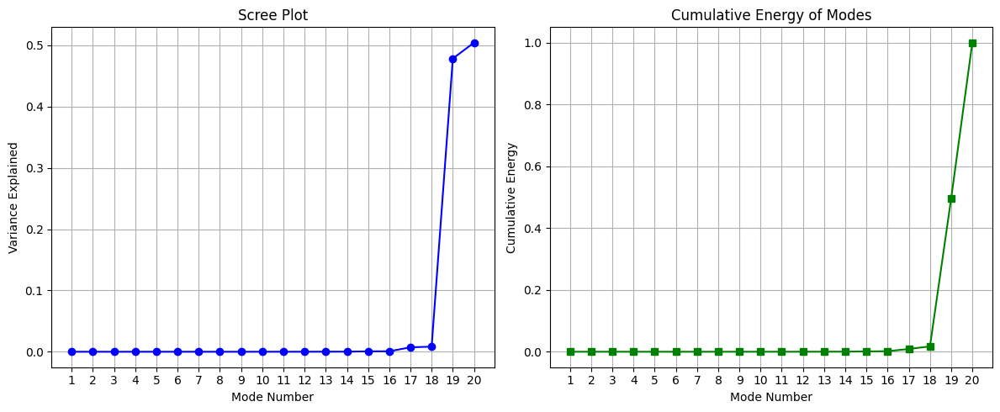

In [62]:
# Singular values
energy = S**2
total_energy = np.sum(energy)
explained_variance = energy / total_energy  # variance explained by each mode
cumulative_energy = np.cumsum(explained_variance)

modes = np.arange(1, len(S)+1)

plt.figure(figsize=(12,5))

# Scree plot
plt.subplot(1,2,1)
plt.plot(modes, explained_variance, 'o-', color='blue')
plt.xlabel('Mode Number')
plt.ylabel('Variance Explained')
plt.title('Scree Plot')
plt.grid(True)
plt.xticks(modes)  # Set x-axis ticks to integers

# Cumulative energy
plt.subplot(1,2,2)
plt.plot(modes, cumulative_energy, 's-', color='green')
plt.xlabel('Mode Number')
plt.ylabel('Cumulative Energy')
plt.title('Cumulative Energy of Modes')
plt.grid(True)
plt.xticks(modes)  # Set x-axis ticks to integers

plt.tight_layout()
plt.show()

Now let's try to fit SINDy on the first 4 POD modes. The idea is to find some underlaying dynamic in POD coordinates, and do our time integration there... without the need for a neural network autoencoder...

In [63]:
# Project data onto the first 4 modes
modes = 2
length = 801

# print(f'u.shape: {u.shape}, v.shape: {v.shape}')
# u_real = u.reshape((flat_dim, t, realizations))
# v_real = v.reshape((flat_dim, t, realizations))

# print(f'u_real.shape: {u_real.shape}, v_real.shape: {v_real.shape}')
# u_real = u_real[:, :, 25]
# v_real = v_real[:, :, 25]

# print(f'u_real.shape: {u_real.shape}, v_real.shape: {v_real.shape}')
# full_uv_real = np.vstack((u_real, v_real))
full_uv_realization = np.vstack((u_realization, v_realization))
proj = U[:, :modes].T @ full_uv_realization
proj = proj.T

print(proj.shape)

# proj = U[:, :modes].T @ full_uv[:, :length]
# proj = proj.T

# print(proj.shape)
# # Fit SINDy model with polynomial library

model = ps.SINDy(feature_library=ps.PolynomialLibrary(degree=4),
                 optimizer=ps.STLSQ(threshold=5e-2))
model.fit(proj, t=0.05, multiple_trajectories=False)
model.print()

(801, 2)
(x0)' = -0.380 x0 + -0.860 x1 + 30.775 x1^2
(x1)' = 0.914 x0 + -0.144 x1 + 111.666 x0 x1 + 15.416 x1^2


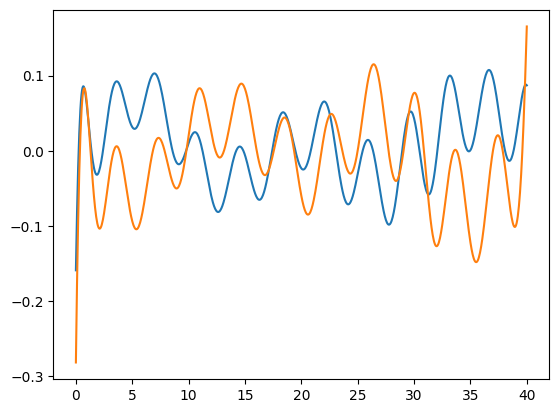

In [53]:
# Plot in POD space the latent dynamics (POD indeed is not a good way to reduce this system, but still...)

time_instances = np.linspace(0, 40, 801)

plt.plot(time_instances, proj, label='Projection onto first 2 POD modes')
plt.show()

u.shape: (50, 50, 801, 30), v.shape: (50, 50, 801, 30)
u_real.shape: (2500, 801, 30), v_real.shape: (2500, 801, 30)
u_real.shape: (2500, 801), v_real.shape: (2500, 801)
(801, 2)
(x0)' = -0.862 x0 + -0.960 x1 + 0.105 x0^2 + -0.114 x0^3 + 1.259 x0^2 x1 + 1.318 x0 x1^2 + 0.322 x1^3
(x1)' = 2.558 x0 + 0.965 x1 + -0.248 x0^2 + -0.080 x0 x1 + -0.626 x0^3 + -2.723 x0^2 x1 + -2.148 x0 x1^2 + -0.330 x1^3


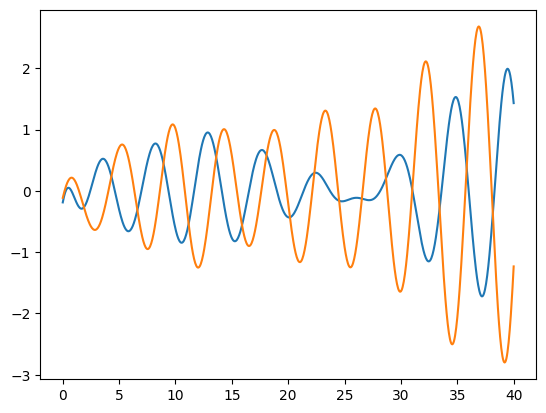

In [30]:
# Project data onto the first 4 modes
modes = 2
length = 801

print(f'u.shape: {u.shape}, v.shape: {v.shape}')
u_real = u.reshape((flat_dim, t, realizations))
v_real = v.reshape((flat_dim, t, realizations))

print(f'u_real.shape: {u_real.shape}, v_real.shape: {v_real.shape}')
u_real = u_real[:, :, 25]
v_real = v_real[:, :, 25]

print(f'u_real.shape: {u_real.shape}, v_real.shape: {v_real.shape}')
full_uv_real = np.vstack((u_real, v_real))
proj = U[:, :modes].T @ full_uv_real
proj = proj.T

print(proj.shape)

# proj = U[:, :modes].T @ full_uv[:, :length]
# proj = proj.T

# print(proj.shape)
# # Fit SINDy model with polynomial library

model = ps.SINDy(feature_library=ps.PolynomialLibrary(degree=3),
                 optimizer=ps.STLSQ(threshold=5e-2))
model.fit(proj, t=0.05, multiple_trajectories=False)
model.print()

time_instances = np.linspace(0, 40, 801)

plt.plot(time_instances, proj, label='Projection onto first 2 POD modes')
plt.show()

## A quick sanity check... 

Verify that the realizations indeed look normal

Animation size has reached 20985563 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


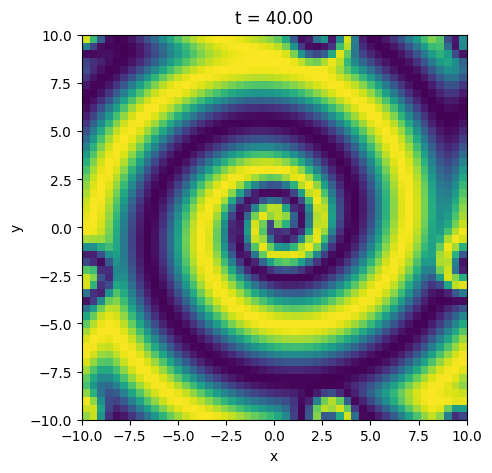

In [38]:
realization = 25

#field = u[:, :, :, realization]  # shape: (nx, ny, nt)
field = u_realization.reshape((50, 50, 801))
fig, ax = plt.subplots(figsize=(5,5))
cax = ax.imshow(field[:, :, 0], origin='lower',
                extent=[-10, 10, -10, 10])

vmin, vmax = field.min(), field.max()
cax.set_clim(vmin, vmax)

ax.set_xlabel('x')
ax.set_ylabel('y')

time_instances = np.linspace(0, 40, 800)

# Use ax.text instead of ax.set_title
time_text = ax.text(0.5, 1.02, f't = {time_instances[0]:.2f}', transform=ax.transAxes,
                    ha='center', va='bottom', fontsize=12)

def update(frame):
    cax.set_data(field[:, :, frame])
    time_text.set_text(f't = {time_instances[frame]:.2f}')  # update the text
    return [cax, time_text]

# Use blit=False for safety
anim = FuncAnimation(fig, update, frames=len(time_instances), interval=50, blit=False)
HTML(anim.to_jshtml())